<!-- HTML file automatically generated from DocOnce source (https://github.com/doconce/doconce/)
doconce format html Project1.do.txt  -->
<!-- dom:TITLE: Quantum Computing and Quantum Machine Learning, Project 1 -->

## Introduction

The aim of this project is study the fundamentals concepts as well as analytical and numerical tools for understanding of the quantum computing. 
To introduce us to this quantum world, a first step is to know a very important definition: **Qubit**. Qubit is a basic unit of the quantum information, we can say colloquially that "It is the quantum version of a bit". 

Unlike bits, which it can have two different values: 0 or 1; qubits can have this values, but also can have mixed values between the two above values. Mixed values means the qubits can be in superposition state.

\begin{equation}
\vert \Psi \rangle = \alpha \vert 0\rangle + \beta \vert 1\rangle 
\end{equation}

where $\alpha$ and $\beta$ are the complex amplitudes. This idea is much better to see in the Bloch sphere.

On this representative scheme, we can see that our two basis $|0\rangle$ and $|1\rangle$ are in the poles of the sphere.

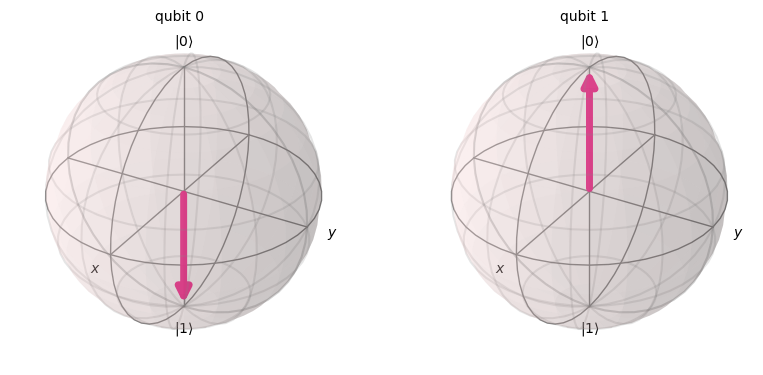

In [14]:
from qiskit import QuantumCircuit
from qiskit.quantum_info import Statevector
from qiskit.visualization import plot_bloch_multivector

qc = QuantumCircuit(2)
qc.x(0)

state = Statevector(qc)
plot_bloch_multivector(state)

State vector can describe a lot of points on the surface of the Bloch sphere, which represents pure qubit states.

In [15]:
from qiskit.visualization import visualize_transition
qc = QuantumCircuit(1)
qc.x(0)
qc.y(0)
qc.h(0)
visualize_transition(qc)

## Part a)

Write a function which sets up a one-qubit basis and apply the various
Pauli matrices to these basis states.  Apply the Hadamard and Phase
gates to the same one-qubit basis states and study their actions on
these states. Define also Bell states and write a code where you
implement a Hadamard gate and thereafter a **CNOT** gate on one of the Bell
states of your choice. Perform thereafter a measurement on the first qubit and
thereafter on the second qubit. The measurements should be performed 
several times and it is the average results of these measurements
which should be discussed and presented.

Compare your code with the results obtained using **Qiskit** from the lectures of week 5.

<span style="color:red">Solution:</span>

**Exercise 1**

We define a function for one qubit, as a superposition. It is a arbitrary function. 

\begin{equation}
\vert \Psi \rangle = \alpha \vert 0\rangle + \beta \vert 1\rangle 
\end{equation}

with the computational basis

\begin{equation}
\vert 0\rangle = 
\begin{bmatrix} 
1 \\ 
0 
\end{bmatrix}, \hspace{1cm}
\vert 1\rangle = 
\begin{bmatrix} 
0 \\ 
1 
\end{bmatrix}
\end{equation}

Pauli matrices

\begin{equation}
\sigma_{x}= 
\begin{bmatrix} 
0 & 1 \\ 
1 & 0
\end{bmatrix} \hspace{1cm}
\sigma_{y}= 
\begin{bmatrix} 
0 & -i \\ 
i & 0
\end{bmatrix} \hspace{1cm}
\sigma_{z}= 
\begin{bmatrix} 
1 & 0 \\ 
0 & -1
\end{bmatrix}
\end{equation}

Now we apply the Pauli matrices to the function for one qubit

In [ ]:
from sympy import *
import numpy as np

# beta = b and alpha = a
a, b = symbols('a b') 

# Computational basis
statezero = np.array([[1],[0]])   #state zero
stateone = np.array([[0],[1]])    #state one

# Wave function for 1 qubit
wf = a*statezero + b*stateone    

# Pauli Matrix
X = np.array([[0,1],
             [1,0]])
Y = np.array([[0,-1j],
             [1j,0]])
Z = np.array([[1,0],
             [0,-1]])

print(X @ wf, '= X.WF')                              # "@" means product matrix by matrix
print('----------------------------------------')
print('----------------------------------------')
print(Y @ wf, '= Y.WF')                              # Product Pauli matrix Y by wave function
print('----------------------------------------')
print('----------------------------------------')
print(Z @ wf, '= Z.WF')
print('----------------------------------------')
print('----------------------------------------')

Solutions:

\begin{equation}
\sigma_{x}\vert \Psi\rangle= 
\begin{bmatrix} 
\beta \\ 
\alpha
\end{bmatrix}, \hspace{1cm}
\sigma_{y}\vert \Psi\rangle= 
\begin{bmatrix} 
-i\beta \\ 
i\alpha
\end{bmatrix}, \hspace{1cm}
\sigma_{z}\vert \Psi\rangle= 
\begin{bmatrix} 
\alpha\\ 
-\beta
\end{bmatrix}
\end{equation}

\begin{equation}
\sigma_{x}\vert \Psi\rangle= \beta
\begin{bmatrix} 
1 \\ 
0
\end{bmatrix} 
+ \alpha
\begin{bmatrix} 
0 \\ 
1
\end{bmatrix} = \beta |0\rangle + \alpha |1\rangle, \hspace{1cm}
\sigma_{y}\vert \Psi\rangle= -i \left(\beta
\begin{bmatrix} 
 1\\ 
0
\end{bmatrix}
- \alpha
\begin{bmatrix} 
 0\\ 
1
\end{bmatrix}\right) = -i(\beta |0\rangle - \alpha |1\rangle), \hspace{1cm}
\sigma_{z}\vert \Psi\rangle= \alpha
\begin{bmatrix} 
1\\ 
0
\end{bmatrix}
- \beta
\begin{bmatrix} 
0\\ 
1
\end{bmatrix} = \alpha |0\rangle - \beta |1\rangle
\end{equation}

**Exercise 2**

Quantum gates

\begin{equation}
H= \frac{1}{\sqrt{2}}
\begin{bmatrix} 
1 & 1 \\ 
1 & -1
\end{bmatrix}, \hspace{1cm}
S= 
\begin{bmatrix} 
1 & 0 \\ 
0 & i
\end{bmatrix}, \hspace{1cm}
T\left(\frac{\pi}{8}\right)= 
\begin{bmatrix} 
1 & 0 \\ 
0 & e^{\frac{i\pi}{4}}
\end{bmatrix} =
\begin{bmatrix} 
1 & 0 \\ 
0 & \frac{1}{\sqrt{2}}(1-i)
\end{bmatrix}
\end{equation}

Applying the gates to the function for one qubit

In [ ]:
# Hardamard gate
H = np.sqrt(0.5)*np.array([[1,1],
                           [1,-1]])
# S gate
S =  np.array([[1,0],
               [0,1j]])
# T(pi/8) gate
T = np.array([[1,0],
               [0,np.sqrt(0.5)*(1-1j)]])   # exp(i*pi/4) = cos(pi/4) - i*sin(pi/4) = np.sqrt(0.5)*(1-i)


print(H @ wf, '= H.WF')  # Product Hardamard gate by wave function
print('------------------------------------------------')
print('------------------------------------------------')
print(S @ wf, '= S.WF')
print('------------------------------------------------')
print('------------------------------------------------')
print(T @ wf, '= T.WF')
print('------------------------------------------------')
print('------------------------------------------------')

Solutions:

\begin{equation}
H\vert \Psi\rangle = \frac{1}{\sqrt{2}}
\begin{bmatrix} 
\alpha + \beta \\ 
\alpha - \beta 
\end{bmatrix} = \frac{1}{\sqrt{2}} \left( \alpha
\begin{bmatrix} 
1 \\ 
0 
\end{bmatrix} 
- \beta
\begin{bmatrix} 
0 \\ 
1 
\end{bmatrix}
+ \alpha
\begin{bmatrix} 
0 \\ 
1 
\end{bmatrix}
+ \beta
\begin{bmatrix} 
1 \\ 
0 
\end{bmatrix} \right) = \frac{1}{\sqrt{2}} \left( \alpha |0\rangle - \beta |1\rangle + \alpha |1\rangle + \beta |0\rangle \right)
\end{equation}

\begin{equation}
S\vert \Psi\rangle = 
\begin{bmatrix} 
\alpha \\ 
i\beta 
\end{bmatrix} = \alpha
\begin{bmatrix} 
1 \\ 
0 
\end{bmatrix}
+ i\beta
\begin{bmatrix} 
0 \\ 
1 
\end{bmatrix} = \alpha |0\rangle + i\beta |1\rangle
\end{equation}

\begin{equation}
T\left(\frac{\pi}{8}\right) = 
\begin{bmatrix} 
\alpha \\ 
\frac{1}{\sqrt{2}}\beta(1-i) 
\end{bmatrix} = \alpha 
\begin{bmatrix} 
1 \\ 
0
\end{bmatrix}
+ \frac{1}{\sqrt{2}}\beta(1-i)
\begin{bmatrix} 
0 \\ 
1
\end{bmatrix} = \alpha |0\rangle + \frac{1}{\sqrt{2}}\beta(1-i)|1\rangle
\end{equation}

**Exercise 3**

Following the class ideas (week 2), aplying the Hamiltonian to the computational basis
\begin{equation}
       H_0\vert 0 \rangle =\epsilon_0\vert 0 \rangle
\end{equation}

\begin{equation}
       H_0\vert 1\rangle =\epsilon_1\vert 1\rangle
\end{equation}

therefore

\begin{equation}
H=
\left(\begin{array}{cc}
  \epsilon_0+\lambda X_0 &\lambda X \\
  \lambda X &\epsilon_1+\lambda X_1 \end{array}\right)
\end{equation}

with $\lambda = 1$

\begin{equation}
H=
\left(\begin{array}{cc}
 \epsilon_0+X_0 & X \\
 X &\epsilon_1+ X_1 \end{array}\right)
\end{equation}

and change $\epsilon_0+X_0 = \epsilon /2$, $\epsilon_1+ X_1 = -\epsilon/2$ and $X = \delta/2$

\begin{equation}
H=\frac{1}{2}
\left(\begin{array}{cc}
  \epsilon & \delta \\
 \delta &\epsilon \end{array}\right)
\end{equation}

\begin{equation}
H=\frac{1}{2}
\left \{ \epsilon
\left(\begin{array}{cc}
  1 & 0 \\
  0 & -1 \end{array}\right)
 + \delta 
 \left(\begin{array}{cc}
  0 & 1 \\
  1 & 0 \end{array} \right) \right \}
\end{equation}

\begin{equation}
H=\frac{1}{2}
\left \{ \epsilon \sigma_{z}
 + \delta \sigma_{x} \right \}
\end{equation}

**Exercise 4**

Multiplying the states $A$ and $B$, remember use the tensor product

\begin{equation}
\vert \Psi \rangle = \vert \phi_{A} \rangle \otimes \vert \phi_{B} \rangle
\end{equation}

\begin{equation}
\vert \Psi \rangle = \left( \alpha\vert 0\rangle + \beta\vert 1\rangle \right) \otimes \left( \alpha\vert 0\rangle + \beta\vert 1\rangle \right) = \alpha^{2}\vert 0\rangle \otimes \vert 0\rangle + \beta \alpha \vert 1\rangle \otimes \vert 0\rangle + \alpha \beta \vert 0\rangle \otimes \vert 1\rangle + \beta^{2}\vert 1\rangle \otimes \vert 1\rangle
\end{equation}

if $\alpha = \beta = \frac{1}{\sqrt{2}}$

\begin{equation}
\vert \Psi \rangle = \frac{1}{2}\left \{ \vert 0\rangle \otimes \vert 0\rangle + \vert 1\rangle \otimes \vert 0\rangle + \vert 0\rangle \otimes \vert 1\rangle + \vert 1\rangle \otimes \vert 1\rangle \right \} = \frac{1}{2}\left \{\vert 00\rangle + \vert 10\rangle + \vert 01\rangle + \vert 11\rangle \right \}
\end{equation}

For two qubits is necessary to define the Bell states. The Bell basis is a set of four two qubit wave functions, they are examples of quantum entanglement.

\begin{equation}
\vert \Psi^+\rangle = \frac{1}{\sqrt{2}}\left[\vert 10\rangle +\vert 01\rangle\right]=\frac{1}{\sqrt{2}}\begin{bmatrix} 0 \\ 1 \\ 1 \\ 0\end{bmatrix}
\end{equation}

\begin{equation}
\vert \Psi^-\rangle = \frac{1}{\sqrt{2}}\left[\vert 10\rangle -\vert 01\rangle\right]=\frac{1}{\sqrt{2}}\begin{bmatrix} 0 \\ -1 \\ 1 \\ 0\end{bmatrix}
\end{equation}

\begin{equation}
\vert \Phi^+\rangle = \frac{1}{\sqrt{2}}\left[\vert 00\rangle +\vert 11\rangle\right]=\frac{1}{\sqrt{2}}\begin{bmatrix} 1 \\ 0 \\ 0 \\ 1\end{bmatrix}
\end{equation}

\begin{equation}
\vert \Phi^-\rangle = \frac{1}{\sqrt{2}}\left[\vert 00\rangle -\vert 11\rangle\right]=\frac{1}{\sqrt{2}}\begin{bmatrix} 1 \\ 0 \\ 0 \\ -1\end{bmatrix}
\end{equation}

#### Hadamard gate and CNOT gate on the Bell states
We can produce this states using Hardamard gate, Pauli matrices and CNOT gate. Those are simple quantum circuits

#### For $\vert \Phi^+\rangle$

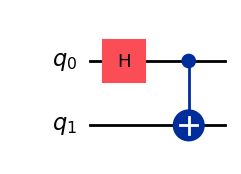

In [88]:
from qiskit import QuantumCircuit
 
# Circuit with two qubits
qc = QuantumCircuit(2)
 
# Apply the Hardamard gate on qubit 0 
qc.h(0)
 
# Apply CNOT gate on qubit 1, controlled by qubit 0
qc.cx(0, 1)

# Draw the circuit 
qc.draw("mpl")

where $q_{0} = \vert 0\rangle_{A}$ and $q_{1} = \vert 0\rangle_{B}$

Steps calculations

\begin{equation}
\text{First step} \hspace{1cm} \longrightarrow \hspace{1cm}
H\vert 0\rangle = \frac{1}{\sqrt{2}}
\begin{bmatrix} 
1 & 1 \\ 
1 & -1
\end{bmatrix}
\begin{bmatrix} 
1 \\ 
0
\end{bmatrix}
=\frac{1}{\sqrt{2}}
\begin{bmatrix} 
1 \\ 
1
\end{bmatrix}
=\frac{1}{\sqrt{2}}\left(\vert 0\rangle + \vert 1\rangle \right)
\end{equation}

\begin{equation}
\text{Second step} \hspace{1cm} \longrightarrow \hspace{1cm}
(H\vert 0\rangle)\otimes \vert 0\rangle = \frac{1}{\sqrt{2}}(\vert 0\rangle + \vert 1\rangle)\otimes \vert 0\rangle =
\frac{1}{\sqrt{2}}(\vert 00\rangle + \vert 11\rangle) = \vert \Phi^{+}\rangle
\end{equation}

Remind CNOT operation

\begin{equation}
\vert 0\rangle \otimes \vert 0\rangle \hspace{1cm} \longrightarrow \hspace{1cm} \vert 00\rangle
\end{equation}
\begin{equation}
\vert 0\rangle \otimes \vert 1\rangle \hspace{1cm} \longrightarrow \hspace{1cm} \vert 01\rangle
\end{equation}
\begin{equation}
\vert 1\rangle \otimes \vert 0\rangle \hspace{1cm} \longrightarrow \hspace{1cm} \vert 11\rangle
\end{equation}
\begin{equation}
\vert 1\rangle \otimes \vert 1\rangle \hspace{1cm} \longrightarrow \hspace{1cm} \vert 10\rangle
\end{equation}

Calculations for the others cases are similar

#### For $\vert \Phi^-\rangle$

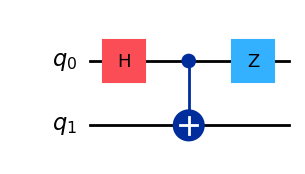

In [23]:
from qiskit import QuantumCircuit
 
qc = QuantumCircuit(2)
 
qc.h(0)
qc.cx(0, 1)
qc.z(0)      # Apply Pauli matrix Z on qubit 0
 
qc.draw("mpl")

#### For $\vert \Psi^+\rangle$

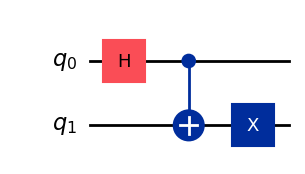

In [24]:
from qiskit import QuantumCircuit
 
qc = QuantumCircuit(2)
 
qc.h(0)
qc.cx(0, 1)
qc.x(1)       # Apply Pauli matrix X on qubit 1
 
qc.draw("mpl")

#### For $\vert \Psi^-\rangle$

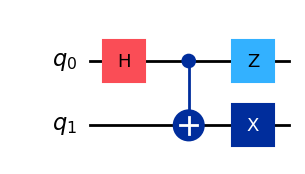

In [25]:
from qiskit import QuantumCircuit
 
qc = QuantumCircuit(2)
 
qc.h(0)
qc.cx(0, 1)
qc.z(0)  
qc.x(1)      
 
qc.draw("mpl")

#### Calculation: Bell state $\vert \Phi^+\rangle$

In [ ]:
For this calculation we have use Qiskit package

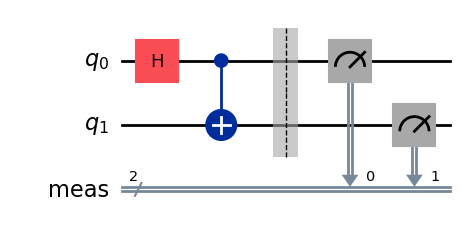

In [90]:
from qiskit import QuantumCircuit
import qiskit_aer
from qiskit.visualization import plot_histogram
#import numpy as np

backend = qiskit_aer.Aer.get_backend('qasm_simulator')

qc = QuantumCircuit(2)

qc.h(0)
qc.cx(0, 1)
qc.measure_all()
qc.draw('mpl')

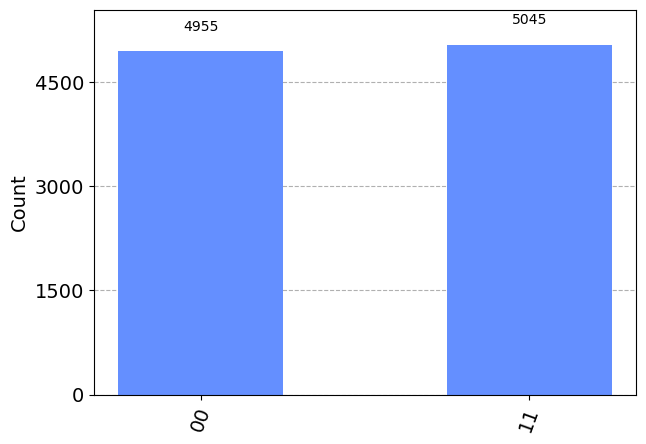

In [91]:
job = backend.run(qc, shots=10000)
result = job.result()

counts = result.get_counts(qc)
plot_histogram(counts)

We also have created other code using the probabilities to find each qubit. If you check the previous calculations for this state, it is possible to see that probability to find either $|0\rangle$ or $|1\rangle$ is the same, equal to 0.5 .

Following this approach, we can generate random number in some interval, there the range is from $0$ to $1$, since we consider the probabilities of finding the qubits.

You can check the created code in **[VESTA](https://jp-minerals.org/vesta/en/)**

#### Bell states - example taked from week 5 (Created by Keran). It's only for comparation.

Quantum Circuit:


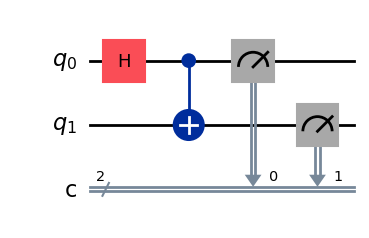

In [34]:
from qiskit import QuantumCircuit, transpile, assemble # ..., IBMQ
from qiskit.visualization import circuit_drawer, plot_histogram
import qiskit_aer
import matplotlib.pyplot as plt

# Create a quantum circuit with two qubits
bell_circuit = QuantumCircuit(2, 2)

# Apply Hadamard gate to the first qubit
bell_circuit.h(0)

# Apply a CNOT gate with the first qubit as the control and the second qubit as the target
bell_circuit.cx(0, 1)

# Add measurements to the circuit
bell_circuit.measure([0, 1], [0, 1])

# Visualize the circuit
print("Quantum Circuit:")
#print(bell_circuit)
bell_circuit.draw("mpl")
#bell_circuit.draw(output='latex')

In [35]:
# Number of shots
num_shots = 10000

# Simulate the circuit using the Aer simulator
simulator = qiskit_aer.Aer.get_backend('qasm_simulator')

# Transpile the circuit for the simulator
transpiled_circuit = transpile(bell_circuit, simulator)

# Execute the transpiled circuit on the simulator with the specified number of shots
result = simulator.run(transpiled_circuit, shots=num_shots).result()

# Get measurement counts
counts = result.get_counts(bell_circuit)

# Get and print the measurement results
counts = result.get_counts(bell_circuit)
print("\nMeasurement Results:")
print(counts)


Measurement Results:
{'00': 5019, '11': 4981}


Now we compare both codes

Histrogram of code taked from week 5:


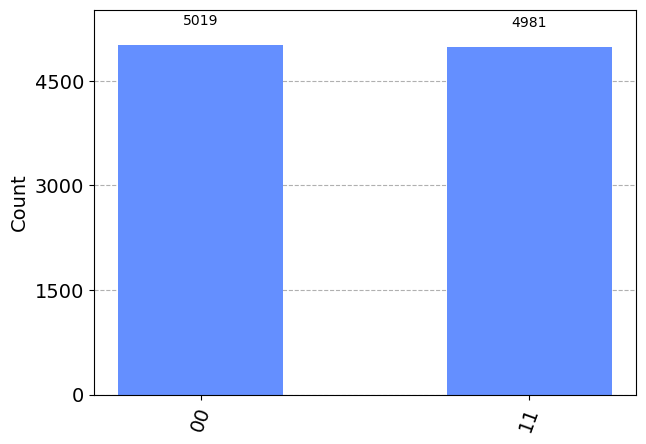

In [36]:
print("Histrogram of code taked from week 5:")
plot_histogram(counts)

<span style="color:red">Comment:</span> The count after the mesuarement have a strong relation with the probabilities for each qubit. The count for the created code will not give us the same values to the code from qiskit, since it is a probabilistic case. However they should be within an acceptable range.